In [1]:
%pylab inline
plt.style.use('seaborn-whitegrid')
pylab.rcParams['figure.figsize'] = (10.0, 6.0)

Populating the interactive namespace from numpy and matplotlib


In [2]:
def point_to_point_traj(x1, x2, v1, v2, delta_t):
  t = np.linspace(0, delta_t, 100)  
  a0 = x1
  a1 = v1
  a2 = (3*x2 - 3*x1 - 2*v1*delta_t - v2 * delta_t) / (delta_t**2)
  a3 = (2*x1 + (v1 + v2) * delta_t  - 2 * x2) / (delta_t**3)

  polynomial = a0 + a1 * t + a2 * t**2 + a3 * t**3
  derivative = a1 + 2*a2 * t + 3 * a3 * t**2
  return polynomial, derivative


def piecewise2D (X,Y, Vx, Vy, T):
    theta_x, theta_y, dx, dy = [], [], [], []

    for i in range(len(P)-1):          
        theta_xi, dxi = point_to_point_traj(X[i], X[i+1], Vx[i], Vx[i+1], T[i+1] - T[i])
        theta_yi, dyi = point_to_point_traj(Y[i], Y[i+1], Vy[i], Vy[i+1], T[i+1] - T[i])

        theta_x += theta_xi.tolist()
        theta_y += theta_yi.tolist()
        dx += dxi.tolist()
        dy += dyi.tolist()

        plot(theta_xi, theta_yi)
    return theta_x, theta_y, dx, dy

In [3]:
# Plotting
def plot_points():
    plot(X,Y, '--')
    plot(X,Y, 'o')
    quiver(X,Y, Vx, Vy, color='r')

In [4]:
# Obstacles
def plot_rec(r):
    axis = gca()
    axis.add_patch(Rectangle(
        r[0],
        r[1],
        r[2],
        facecolor=r[3]
    ))

In [5]:
# Obstacles info

r1 = ((4, -1), 2, 10, 'k')
r2 = ((0.5, 2), 2, 3, 'b')
r3 = ((-6, -5), 15, 1, 'k')
r4 = ((8, 0), 2, 5, 'k')
r5 = ((-4, -3), 2, 8, 'k')

rs = [r1, r2, r3, r4, r5]

In [6]:

##### Requirements for the trajectory

# Waypoints
p0 = [-5,-7]
p1 = [10,-7]
p2 = [10,-3]
p3 = [4,-3]
p4 = [3,7]
p5 = [0,7]
p6 = [0,-3]
p7 = [3,-3]
p8 = [4,10]
pf = [9,10]

# Velocities
v0 = [0,-0.001]
v1 = [0,1]
v2 = [-1,0]
v3 = [-0.1,1]
v4 = [-0.2,0]
v5 = [0,-1]
v6 = [1,0]
v7 = [0.1,1.3]
v8 = [0.2,0]
vf = [0, -0.001]

# Time
t0 = 0
t1 = t0 + 15
t2 = t1 + 4
t3 = t2 + 6
t4 = t3 + 10
t5 = t4 + 15
t6 = t5 + 10
t7 = t6 + 3
t8 = t7 + 10
tf = t8 + 25

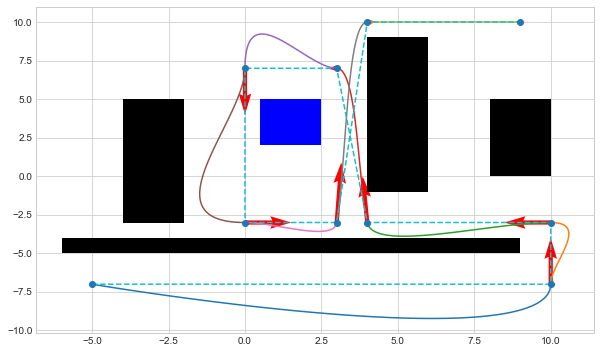

In [7]:
# Convert the initial conditions to a vector form
P = np.vstack((p0, p1, p2, p3, p4, p5, p6, p7, p8, pf))
V = np.vstack((v0, v1, v2, v3, v4, v5, v6, v7, v8, vf))
T = [t0, t1, t2, t3, t4, t5, t6, t7, t8, tf]

X, Y = P[:,0], P[:,1]
Vx, Vy = V[:,0], V[:,1]

# Plot obstacles
for r in rs:
    plot_rec(r)
    

# Plot the trajectory that passes trhough the desired waypoints
theta_x, theta_y, dx, dy = piecewise2D(X,Y, Vx, Vy, T)
plot_points()

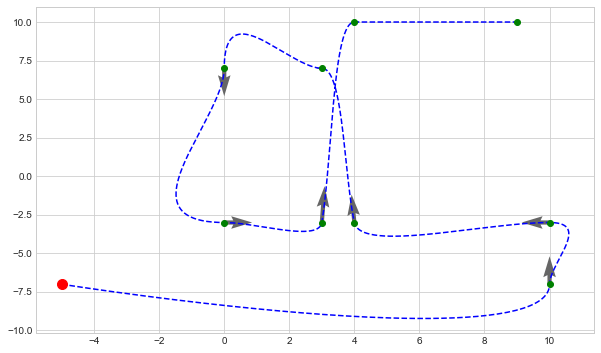

In [8]:
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML
    
matplotlib.rcParams['animation.embed_limit'] = 2**128

fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    ax.plot(theta_x, theta_y, 'b--')
    
    # Initial conditions
    ax.plot(X,Y, 'go')
    ax.quiver(X,Y, Vx, Vy, color='0.4', scale=20)
        
    # Dynamic position
    ax.plot(theta_x[t], theta_y[t], 'ro', markersize=10)
       
    # Velocity vector
    ax.quiver([theta_x[t]], [theta_y[t]], [dx[t]], [dy[t]], color='r', units='xy', scale=10/np.linalg.norm([theta_x[t], theta_y[t]]))
    

anim = animation.FuncAnimation(fig, animate, frames=int(len(theta_x)/1), interval=25)


HTML(anim.to_jshtml())